<a href="https://colab.research.google.com/github/JoseGarza1996/LinearRegression/blob/main/Assignment4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
from scipy import stats

import sklearn
from sklearn.neighbors import LocalOutlierFactor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

from sklearn.model_selection import train_test_split
from sklearn import preprocessing 
from sklearn.metrics import mean_squared_error as MSE
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split, GridSearchCV
import matplotlib.pyplot as plt

from sklearn.linear_model import ElasticNet
from sklearn.datasets import make_regression


pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [ ]:
url1 = 'https://raw.githubusercontent.com/Fauxfox01/data/main/test4.csv'
url2 = 'https://raw.githubusercontent.com/Fauxfox01/data/main/train4.csv'
Test_data = pd.read_csv(url1)
Train_data = pd.read_csv(url2)

## Data Exploration

I am looking for any null variables, I see none so I know I have no missing. I then check the data for other abnormalities. 

In [ ]:
Train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10320 entries, 0 to 10319
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  10320 non-null  int64  
 1   longitude           10320 non-null  float64
 2   latitude            10320 non-null  float64
 3   housing_median_age  10320 non-null  float64
 4   total_rooms         10320 non-null  float64
 5   total_bedrooms      10210 non-null  float64
 6   population          10320 non-null  float64
 7   households          10320 non-null  float64
 8   median_income       10320 non-null  float64
 9   ocean_proximity     10320 non-null  object 
 10  median_house_value  10320 non-null  float64
dtypes: float64(9), int64(1), object(1)
memory usage: 887.0+ KB


In [ ]:
Test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10320 entries, 0 to 10319
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  10320 non-null  int64  
 1   longitude           10320 non-null  float64
 2   latitude            10320 non-null  float64
 3   housing_median_age  10320 non-null  float64
 4   total_rooms         10320 non-null  float64
 5   total_bedrooms      10223 non-null  float64
 6   population          10320 non-null  float64
 7   households          10320 non-null  float64
 8   median_income       10320 non-null  float64
 9   ocean_proximity     10320 non-null  object 
dtypes: float64(8), int64(1), object(1)
memory usage: 806.4+ KB


In [ ]:

X_train = Train_data.iloc[:, 1:]
X_columns = X_train.columns


X_test = Test_data.iloc[:, 1:]

idC = Test_data.iloc[:, :1]

In [ ]:
X_test.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
count,10320.000000,10320.000000,10320.000000,10320.000000,10223.000000,10320.000000,10320.000000,10320.000000
mean,-119.545618,35.615726,28.734496,2618.652132,534.447618,1419.335368,496.085756,3.859291
std,2.001661,2.139561,12.565620,2146.682432,414.803421,1120.790562,376.543945,1.897334
min,-124.300000,32.550000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900
25%,-121.770000,33.930000,18.000000,1437.000000,297.000000,788.000000,281.000000,2.543150
50%,-118.470000,34.240000,29.000000,2116.000000,431.000000,1167.500000,406.000000,3.517900
75%,-118.000000,37.710000,37.000000,3148.250000,645.000000,1726.000000,602.000000,4.750000
max,-114.310000,41.950000,52.000000,37937.000000,5471.000000,35682.000000,5189.000000,15.000100


I replace the missing variable with the mean, I also one hot encode ocean_proximity

In [ ]:

Y_train = X_train.iloc[:, 9:10]
X_train = X_train.iloc[:, :9]

hot = pd.get_dummies(X_test.ocean_proximity)

X_test[hot.columns] = hot

hot = pd.get_dummies(X_test.ocean_proximity)
X_train[hot.columns] = hot


features=list(X_train.columns)
X_train = pd.concat([X_train, Y_train], axis=1)
X_train.columns = features + ['median_house_value']

X_train = X_train.drop('ocean_proximity', axis=1)
X_test = X_test.drop('ocean_proximity', axis=1)



X_test['total_bedrooms'] = X_test['total_bedrooms'].fillna(X_test['total_bedrooms'].mean())
X_train['total_bedrooms'] = X_train['total_bedrooms'].fillna(X_train['total_bedrooms'].mean())


X_train

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,median_house_value
0,-122.22,37.77,40.0,494.0,114.000000,547.0,135.0,2.8015,0,0,0,1,0,114800.0
1,-122.29,37.76,18.0,2873.0,763.000000,1243.0,663.0,5.1702,1,0,0,0,0,265400.0
2,-118.48,34.23,29.0,3354.0,707.000000,1752.0,650.0,4.5484,1,0,0,0,0,239900.0
3,-122.19,37.80,48.0,1694.0,259.000000,610.0,238.0,4.7440,0,1,0,0,0,257300.0
4,-121.93,36.63,33.0,1740.0,342.000000,638.0,329.0,3.1912,1,0,0,0,0,319800.0
5,-122.06,37.64,33.0,1160.0,252.000000,729.0,220.0,3.8259,1,0,0,0,0,146100.0
6,-117.94,33.77,32.0,714.0,142.000000,654.0,154.0,4.5052,0,1,0,0,0,170800.0
7,-117.93,33.90,30.0,2629.0,331.000000,956.0,319.0,9.9071,0,1,0,0,0,500001.0
8,-117.39,34.13,9.0,2228.0,398.000000,1316.0,370.0,4.1632,0,0,0,0,1,119800.0
9,-118.21,34.21,41.0,1676.0,263.000000,757.0,255.0,4.7734,0,1,0,0,0,450800.0


In [ ]:

#X_train = X_train[(np.abs(stats.zscore(X_train.iloc[:,:7])) < 4).all(axis=1)]

In [ ]:
X_train

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,median_house_value
0,-122.22,37.77,40.0,494.0,114.000000,547.0,135.0,2.8015,0,0,0,1,0,114800.0
1,-122.29,37.76,18.0,2873.0,763.000000,1243.0,663.0,5.1702,1,0,0,0,0,265400.0
2,-118.48,34.23,29.0,3354.0,707.000000,1752.0,650.0,4.5484,1,0,0,0,0,239900.0
3,-122.19,37.80,48.0,1694.0,259.000000,610.0,238.0,4.7440,0,1,0,0,0,257300.0
4,-121.93,36.63,33.0,1740.0,342.000000,638.0,329.0,3.1912,1,0,0,0,0,319800.0
5,-122.06,37.64,33.0,1160.0,252.000000,729.0,220.0,3.8259,1,0,0,0,0,146100.0
6,-117.94,33.77,32.0,714.0,142.000000,654.0,154.0,4.5052,0,1,0,0,0,170800.0
7,-117.93,33.90,30.0,2629.0,331.000000,956.0,319.0,9.9071,0,1,0,0,0,500001.0
8,-117.39,34.13,9.0,2228.0,398.000000,1316.0,370.0,4.1632,0,0,0,0,1,119800.0
9,-118.21,34.21,41.0,1676.0,263.000000,757.0,255.0,4.7734,0,1,0,0,0,450800.0


I use the natural log to handle the skewed data and I use the natural log of the target vector to ensure I do not get negative values when I predict my score.

In [ ]:
Y_train = X_train.iloc[:, 13:14]
X_train = X_train.iloc[:, :13]


col=['households','median_income','population', 'total_bedrooms', 'total_rooms']
for f in col:
    X_train[f]=np.log(X_train[f])
    X_test[f]=np.log(X_test[f])

Y_train['median_house_value']=np.log(Y_train['median_house_value'])

# Standardization and Normalization

Normalization is already done inside sklearns LinearRegression(). 

In [ ]:
X_train,X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.50)

reg = LinearRegression().fit(X_train, Y_train)
y_pred = reg.predict(X_val)

In [ ]:
Y_val['median_house_value']=np.exp(Y_val['median_house_value'])

I chose to use LinearRegression() for my final submission

In [ ]:
y_pred = pd.DataFrame(y_pred, columns=['predict'])
y_pred['predict']=np.exp(y_pred['predict'])
np.sqrt(MSE(y_pred, Y_val))

66526.47059066336

In [ ]:
Y_val = Y_val.reset_index()

In [ ]:
Y_val = Y_val.drop(['index'], axis=1)


,predict
0,109678.315122
1,137330.399103
2,197985.974220
3,223548.266792
4,111301.097313
5,143310.227844
6,106565.423922
7,406784.838842
8,160242.809255
9,227726.480959


Here I test my predicted values against the actual values to see a big picture overview of my algorithm.

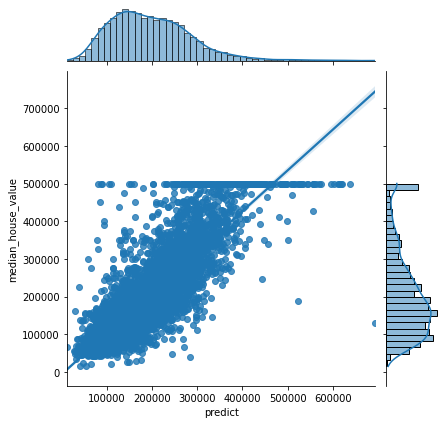

In [ ]:
values = y_pred = pd.concat([y_pred, Y_val], axis=1)
values = values.reset_index()
values = values.drop(['index'],axis=1)
sns.jointplot(x='predict',y='median_house_value',data=values, kind="reg")

In [ ]:
y_pred = np.exp(reg.predict(X_train))

np.sqrt(MSE(y_pred, Y_train))

216441.06321082392

In [ ]:
y_pred = reg.predict(X_test)


In [ ]:
y_pred = np.expm1(y_pred)
y_pred = pd.DataFrame(y_pred)


In [ ]:
y_pred = pd.concat([idC, y_pred], axis=1)
y_pred.columns = ['id', 'median_house_value']

In [ ]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
y_pred

,id,median_house_value
0,0,1.221637e+05
1,1,2.417443e+05
2,2,1.262362e+05
3,3,1.738342e+05
4,4,1.581240e+05
5,5,2.921901e+05
6,6,1.446454e+05
7,7,1.025703e+05
8,8,2.489004e+05
9,9,9.484079e+04


In [ ]:
y_pred.to_csv("./prediction.csv", index=False)

# Kaggle Username

**josedelagarza01**